<div style="background-color:#ddffcc; padding:10px;">

<div style="text-align: center"><h1> Diabetes prediction <h1>
  


<div style="background-color:#ddffcc; padding:10px;">

<span style="font-size:24px; font-weight:bold;">Introduction </span> <br>
Diabetes is a chronic disease that affects millions of people worldwide. Early detection is crucial to prevent complications and manage the disease effectively. In this project, we will be building a machine learning model that can predict whether a person has diabetes based on several features such as age, gender, hypertension, heart disease, smoking history, BMI, HbA1c level, and blood glucose level.
</div>

<div style="background-color:#ddffcc; padding:10px;">
<span style="font-size:24px; font-weight:bold;">About Dataset </span> <br>
The Diabetes prediction dataset is a collection of medical and demographic data from patients, along with their diabetes status (positive or negative). The data includes features such as age, gender, body mass index (BMI), hypertension, heart disease, smoking history, HbA1c level, and blood glucose level. 
    This dataset can be used to build machine learning models to predict diabetes in patients based on their medical history and demographic information. This can be useful for healthcare professionals in identifying patients who may be at risk of developing diabetes and in developing personalized treatment plans. 

<div style="background-color:#ddffcc; padding:10px;">
<span style="font-size:24px; font-weight:bold;">Feature explanation </span> <br>
    
**age** - Age is an important factor as diabetes is more commonly diagnosed in older adults.Age ranges from 0-80 in our dataset. <br> 
    
**gender** - Gender refers to the biological sex of the individual, which can have an impact on their susceptibility to diabetes.<br>
    
**body mass index (BMI)** -BMI (Body Mass Index) is a measure of body fat based on weight and height. Higher BMI values are linked to a higher risk of diabetes. The range of BMI in the dataset is from 10.16 to 71.55. BMI less than 18.5 is underweight, 18.5-24.9 is normal, 25-29.9 is overweight, and 30 or more is obese. <br>
    
**hypertension** - Hypertension is a medical condition in which the blood pressure in the arteries is persistently elevated. It has values a 0 or 1 where 0 indicates they don’t have hypertension and for 1 it means they have hypertension.<br>
    
**heart disease** - Heart disease is another medical condition that is associated with an increased risk of developing diabetes. It has values a 0 or 1 where 0 indicates they don’t have heart disease and for 1 it means they have heart disease. <br>
    
**smoking history** - Smoking history is also considered a risk factor for diabetes and can exacerbate the complications associated with diabetes.In our dataset we have 5 categories i.e not current,former,No Info,current,never and ever. <br>
    
**HbA1c level** - HbA1c (Hemoglobin A1c) level is a measure of a person's average blood sugar level over the past 2-3 months. Higher levels indicate a greater risk of developing diabetes. Mostly more than 6.5% of HbA1c Level indicates diabetes. <br>
    

**blood glucose level**  - Blood glucose level refers to the amount of glucose in the bloodstream at a given time. High blood glucose levels are a key indicator of diabetes.

  

In [166]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from io import StringIO
import pydot

from IPython.display import Image
from sklearn.model_selection import train_test_split as split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier, export_graphviz
import warnings
from sklearn.metrics import log_loss



import warnings
warnings.filterwarnings("ignore")



In [147]:
! pip install imblearn
import imblearn
from imblearn.metrics import specificity_score

In [8]:
# pacages nedded foe size verification
!pip install nbformat
import nbformat
import json

In [42]:
#this runs oner the notebook and calculates the weight of each cell.
# Load the notebook
with open('Diabetes prediction.ipynb', 'r', encoding='utf-8') as file:
    notebook = nbformat.read(file, as_version=nbformat.NO_CONVERT)

# Convert the notebook to JSON
notebook_json = nbformat.writes(notebook)

# Print the size of the notebook in bytes
notebook_size = len(notebook_json.encode('utf-8'))
print(f"Notebook size: {notebook_size} bytes")

# Inspect the cell sizes
cell_sizes = []
for cell in notebook['cells']:
    cell_json = json.dumps(cell)
    cell_size = len(cell_json.encode('utf-8'))
    cell_sizes.append(cell_size)

# Sort and print the cell sizes
sorted_cell_sizes = sorted(cell_sizes, reverse=True)
for i, cell_size in enumerate(sorted_cell_sizes):
    print(f"Cell {i+1} size: {cell_size} bytes")

Notebook size: 18822620 bytes
Cell 1 size: 3795990 bytes
Cell 2 size: 3741268 bytes
Cell 3 size: 2884545 bytes
Cell 4 size: 540757 bytes
Cell 5 size: 353893 bytes
Cell 6 size: 203265 bytes
Cell 7 size: 38796 bytes
Cell 8 size: 35619 bytes
Cell 9 size: 22583 bytes
Cell 10 size: 21238 bytes
Cell 11 size: 17558 bytes
Cell 12 size: 5109 bytes
Cell 13 size: 4412 bytes
Cell 14 size: 2922 bytes
Cell 15 size: 2038 bytes
Cell 16 size: 1918 bytes
Cell 17 size: 1323 bytes
Cell 18 size: 1242 bytes
Cell 19 size: 919 bytes
Cell 20 size: 833 bytes
Cell 21 size: 622 bytes
Cell 22 size: 498 bytes
Cell 23 size: 492 bytes
Cell 24 size: 484 bytes
Cell 25 size: 472 bytes
Cell 26 size: 459 bytes
Cell 27 size: 426 bytes
Cell 28 size: 400 bytes
Cell 29 size: 383 bytes
Cell 30 size: 314 bytes
Cell 31 size: 299 bytes
Cell 32 size: 201 bytes
Cell 33 size: 187 bytes
Cell 34 size: 134 bytes
Cell 35 size: 125 bytes
Cell 36 size: 109 bytes
Cell 37 size: 90 bytes


In [103]:
df=pd.read_csv(r'C:\Users\ALIN\Desktop\Python_Alin\Classification project\diabetis.csv')
print(df.shape)
df.head()

(100000, 9)


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   gender               100000 non-null  object 
 1   age                  100000 non-null  float64
 2   hypertension         100000 non-null  int64  
 3   heart_disease        100000 non-null  int64  
 4   smoking_history      100000 non-null  object 
 5   bmi                  100000 non-null  float64
 6   HbA1c_level          100000 non-null  float64
 7   blood_glucose_level  100000 non-null  int64  
 8   diabetes             100000 non-null  int64  
dtypes: float64(3), int64(4), object(2)
memory usage: 6.9+ MB


### Are there missing values?

In [51]:

df.isnull().sum()

gender                 0
age                    0
hypertension           0
heart_disease          0
smoking_history        0
bmi                    0
HbA1c_level            0
blood_glucose_level    0
diabetes               0
dtype: int64

In [7]:
df.nunique()

gender                    3
age                     102
hypertension              2
heart_disease             2
smoking_history           6
bmi                    4247
HbA1c_level              18
blood_glucose_level      18
diabetes                  2
dtype: int64

### Clean class "other" from gender

In [104]:
#Count the number of each category in gender
male_count = (df['gender']=='Male').sum()
female_count = (df['gender']=='Female').sum()
other_count = (df['gender']=='Other').sum()

print("Male count:", male_count, "Female count:", female_count, "Other count:", other_count)

Male count: 41430 Female count: 58552 Other count: 18


In [105]:
#clean the other class from gender feature
df=df[df['gender']!='Other']
df.shape

(99982, 9)

### Does the data has duplicates?

In [106]:
# Are there duplicate rows?
duplicated_sum = df.duplicated().sum()
print(f"No of Duplicate rows: {duplicated_sum} ")

#Clean duplicated rows
df=df.drop_duplicates()
df.shape

No of Duplicate rows: 3854 


(96128, 9)

In [22]:
df.columns


Index(['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history',
       'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes'],
      dtype='object')

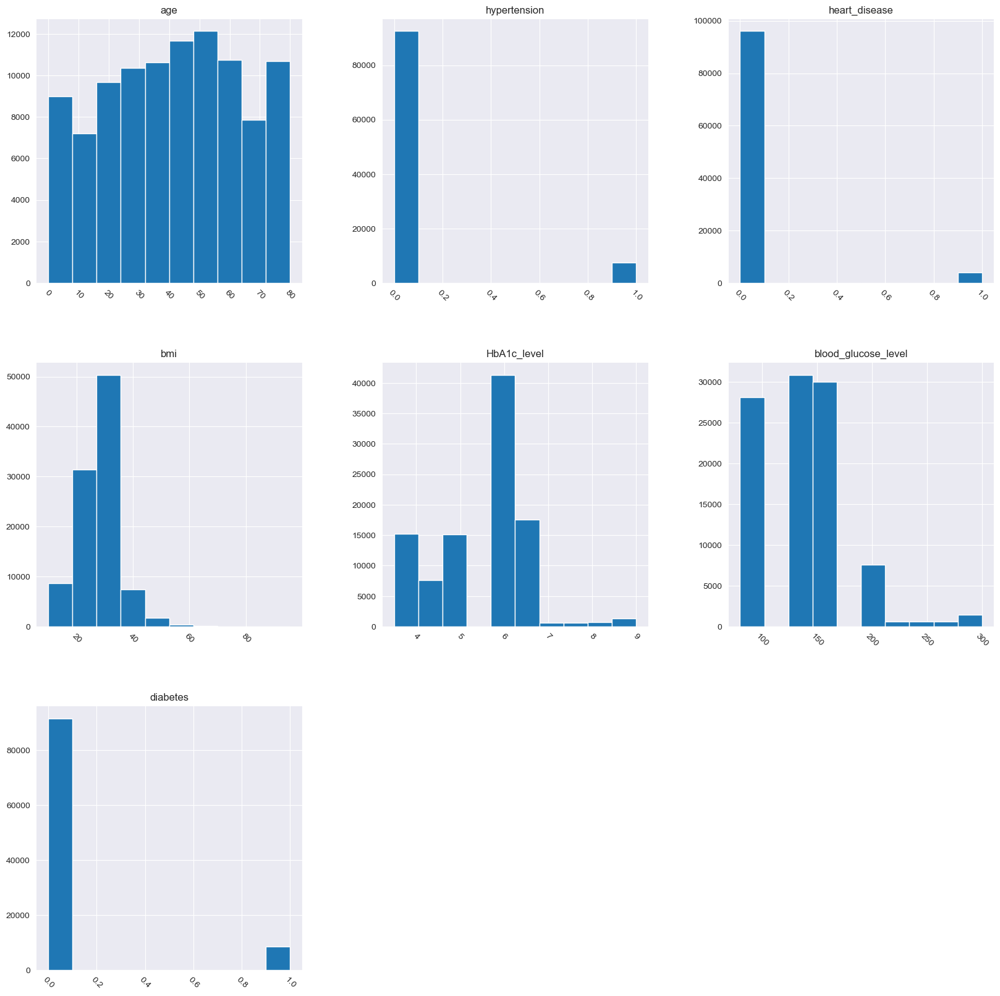

In [10]:
df.hist(figsize=(20,20), xrot=-45)
plt.show()

<AxesSubplot:>

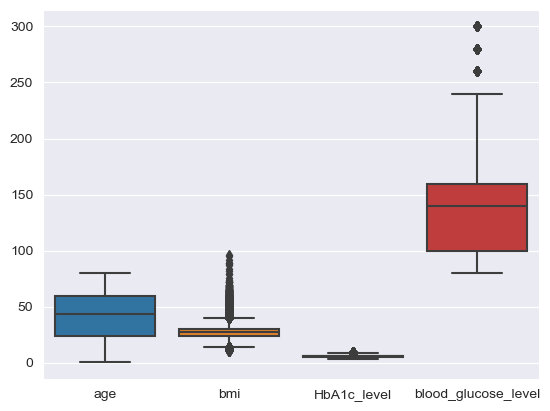

In [23]:
#Do we have outliers in the numerical features?
sns.boxplot(data=df[['age', 'bmi', 'HbA1c_level','blood_glucose_level']])

#We do have outliers in BMI and Blood glucose level, lets look at them

In [24]:
blood_glucose_uniqe=df['blood_glucose_level'].unique()
blood_glucose_uniqe

array([140,  80, 158, 155,  85, 200, 145, 100, 130, 160, 126, 159,  90,
       260, 220, 300, 280, 240], dtype=int64)

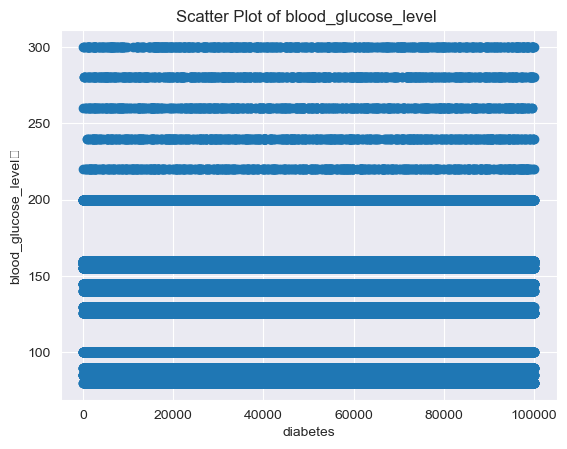

In [25]:
plt.scatter(df.index, df['blood_glucose_level'])
plt.xlabel('diabetes')
plt.ylabel('blood_glucose_level	')
plt.title('Scatter Plot of blood_glucose_level ')
plt.show()
# In blood glucose levels the values are not outlyers - there are 18 categories of values. 

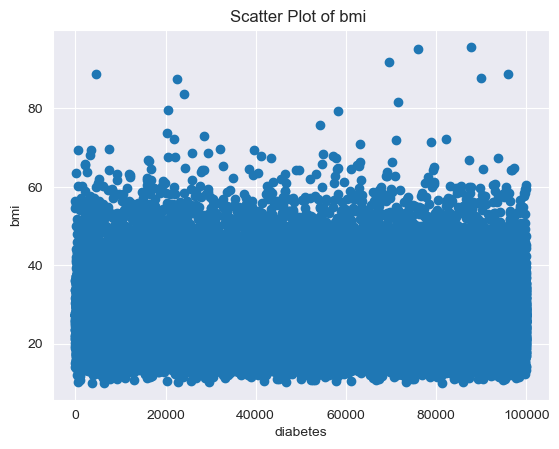

In [26]:
plt.scatter(df.index, df['bmi'])
plt.xlabel('diabetes')
plt.ylabel('bmi')
plt.title('Scatter Plot of bmi ')
plt.show()

### Categorical vs numerical features

In [55]:
cat_columns=df.select_dtypes(['object']).columns
print(cat_columns)
num_columns=df.select_dtypes(['number']).columns
print(num_columns)

Index(['gender', 'smoking_history'], dtype='object')
Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'diabetes'],
      dtype='object')


In [56]:
num_cols = list(set(df._get_numeric_data()))

cat_cols = list(set(df.columns) - set(df._get_numeric_data())) # list of categorical columns

for col in cat_cols:
    print('Unique categories',col, set(df[col]))
    

Unique categories gender {'Male', 'Female'}
Unique categories smoking_history {'never', 'ever', 'former', 'not current', 'No Info', 'current'}


## Visualizations

In [18]:
# What is the percentage of people with diabetes?

diabetes_counts=df['diabetes'].value_counts()
# create the pie chart
fig = go.Figure(data=[go.Pie(labels=['No Diabetes', 'Diabetes'], values=diabetes_counts)])

# update the layout
fig.update_layout(title='Diabetes Distribution')

# show the plot
fig.show()

### Look only on the diabetes ==1 patients

In [20]:
diabetes=df[df['diabetes']==1]
print(diabetes.shape)
diabetes


(8500, 9)


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
6,Female,44.0,0,0,never,19.31,6.5,200,1
26,Male,67.0,0,1,not current,27.32,6.5,200,1
38,Male,50.0,1,0,current,27.32,5.7,260,1
40,Male,73.0,0,0,former,25.91,9.0,160,1
53,Female,53.0,0,0,former,27.32,7.0,159,1
...,...,...,...,...,...,...,...,...,...
99935,Female,65.0,1,1,never,33.55,8.2,140,1
99938,Male,55.0,0,1,former,30.42,6.2,300,1
99957,Female,61.0,0,0,No Info,34.45,6.5,280,1
99962,Female,58.0,1,0,never,38.31,7.0,200,1


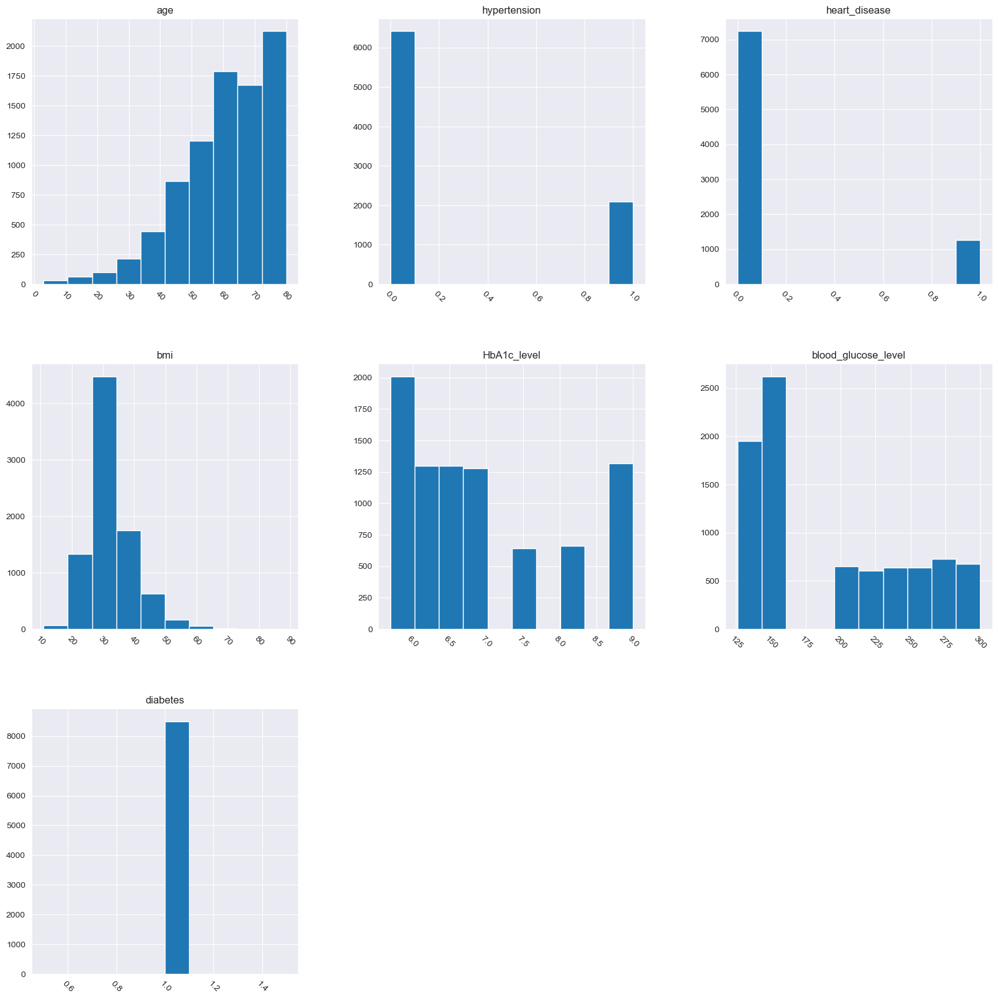

In [21]:
diabetes.hist(figsize=(20,20), xrot=-45)
plt.show()

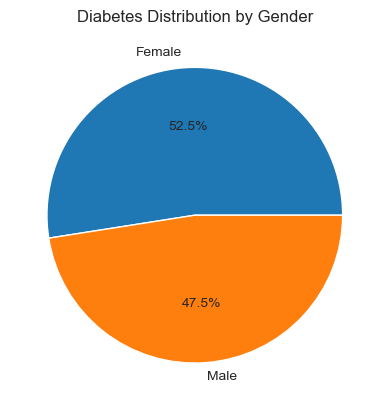

In [23]:
# Is the % of diabetes higher in male or female?

# count the number of males and females with diabetes
diabetes_counts = df[df['diabetes'] == 1]['gender'].value_counts()

# create a pie plot
plt.pie(diabetes_counts, labels=diabetes_counts.index, autopct='%1.1f%%')
plt.title('Diabetes Distribution by Gender')
plt.show()

### Is there a difference between genders?

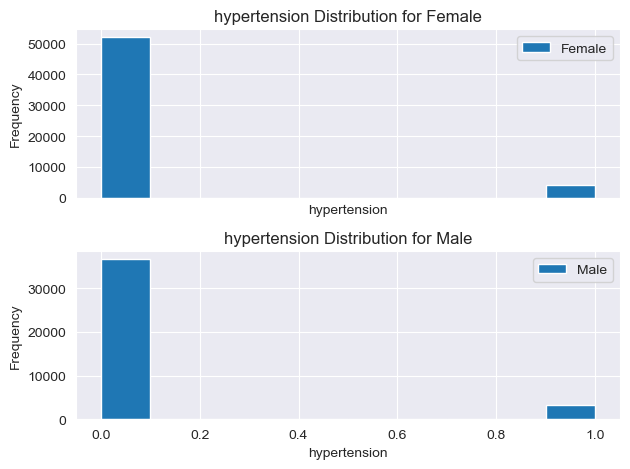

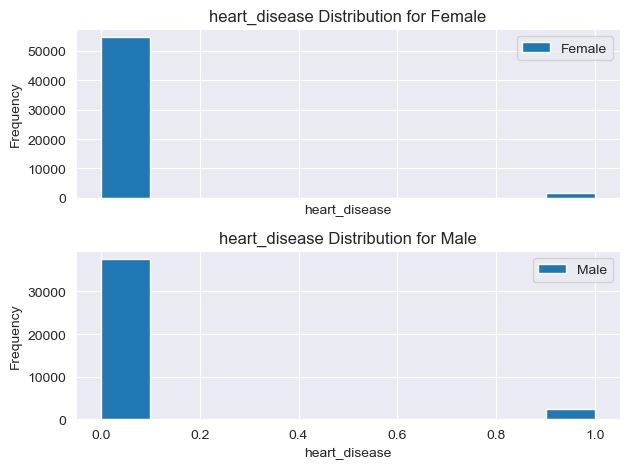

In [76]:
# Group the dataframe by 'gender'
grouped_df = df.groupby('gender')

# Create subplots
fig, axes = plt.subplots(len(grouped_df), sharex=True)

# Iterate over each group and plot histograms
for i, (gender, group) in enumerate(grouped_df):
    # Plot histogram on the corresponding subplot
    axes[i].hist(group['hypertension'], label=gender)
    
    # Customize the subplot
    axes[i].set_xlabel('hypertension')
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'hypertension Distribution for {gender}')
    axes[i].legend()
    
    # Add some space between subplots
    fig.tight_layout()

# Show the plot
plt.show()
# Create subplots
fig, axes = plt.subplots(len(grouped_df), sharex=True)

# Iterate over each group and plot histograms
for i, (gender, group) in enumerate(grouped_df):
    # Plot histogram on the corresponding subplot
    axes[i].hist(group['heart_disease'], label=gender)
    
    # Customize the subplot
    axes[i].set_xlabel('heart_disease')
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'heart_disease Distribution for {gender}')
    axes[i].legend()
    
    # Add some space between subplots
    fig.tight_layout()

# Show the plot
plt.show()


### Males have more heart disease then female.
### No difference with hypertension


In [78]:
df.columns

Index(['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history',
       'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes'],
      dtype='object')

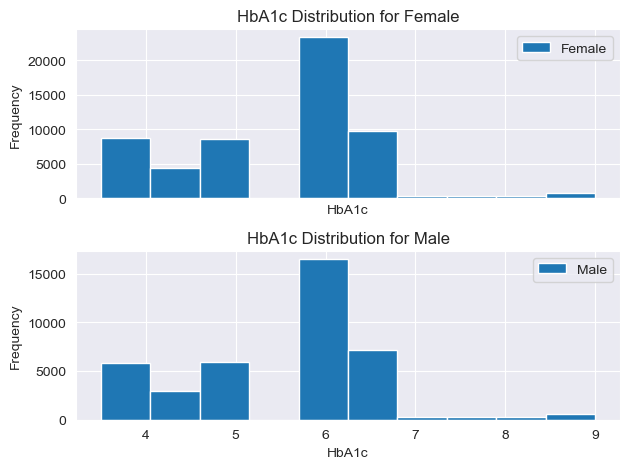

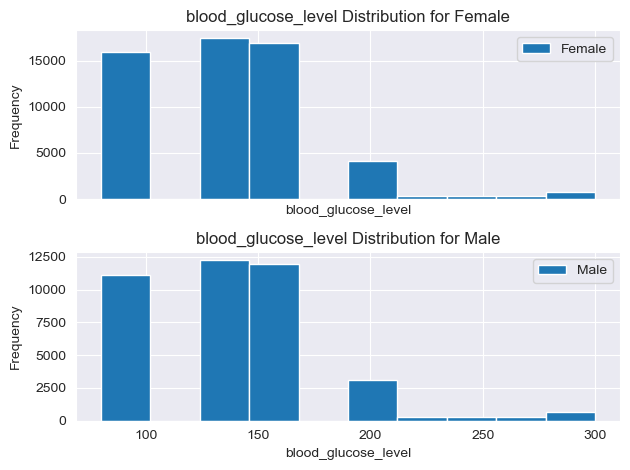

In [79]:


# Create subplots
fig, axes = plt.subplots(len(grouped_df), sharex=True)

# Iterate over each group and plot histograms
for i, (gender, group) in enumerate(grouped_df):
    # Plot histogram on the corresponding subplot
    axes[i].hist(group['HbA1c_level'], label=gender)
    
    # Customize the subplot
    axes[i].set_xlabel('HbA1c')
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'HbA1c Distribution for {gender}')
    axes[i].legend()
    
    # Add some space between subplots
    fig.tight_layout()

# Show the plot
plt.show()

# Create subplots
fig, axes = plt.subplots(len(grouped_df), sharex=True)

# Iterate over each group and plot histograms
for i, (gender, group) in enumerate(grouped_df):
    # Plot histogram on the corresponding subplot
    axes[i].hist(group['blood_glucose_level'], label=gender)
    
    # Customize the subplot
    axes[i].set_xlabel('blood_glucose_level')
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'blood_glucose_level Distribution for {gender}')
    axes[i].legend()
    
    # Add some space between subplots
    fig.tight_layout()

# Show the plot
plt.show()

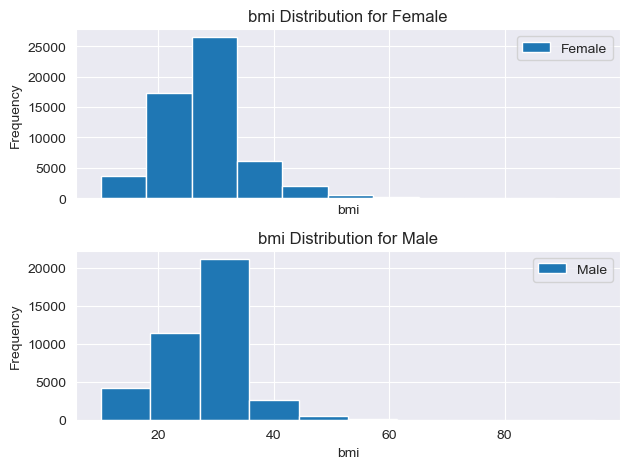

In [80]:
# Create subplots
fig, axes = plt.subplots(len(grouped_df), sharex=True)

# Iterate over each group and plot histograms
for i, (gender, group) in enumerate(grouped_df):
    # Plot histogram on the corresponding subplot
    axes[i].hist(group['bmi'], label=gender)
    
    # Customize the subplot
    axes[i].set_xlabel('bmi')
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'bmi Distribution for {gender}')
    axes[i].legend()
    
    # Add some space between subplots
    fig.tight_layout()

# Show the plot
plt.show()


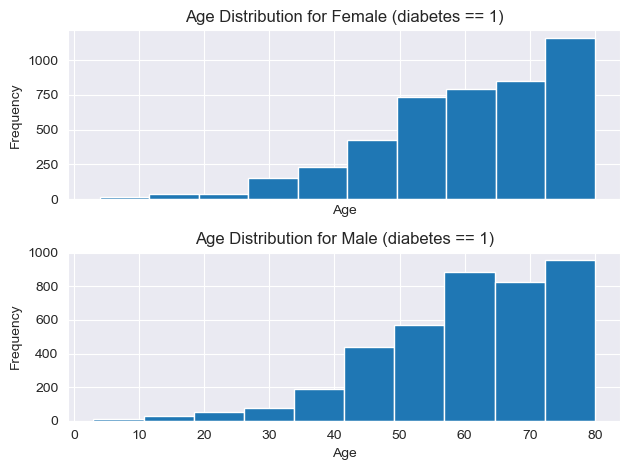

In [84]:
# Get the group where diabetes == 1 for each gender
# Create subplots
fig, axes = plt.subplots(len(grouped_df), sharex=True)

# Iterate over each gender group
for i, (gender, group) in enumerate(grouped_df):
    # Filter the group where diabetes == 1
    diabetes_group = group[group['diabetes'] == 1]
    
    # Plot histogram on the corresponding subplot
    axes[i].hist(diabetes_group['age'])
    
    # Customize the subplot
    axes[i].set_xlabel('Age')
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'Age Distribution for {gender} (diabetes == 1)')
    
    # Add some space between subplots
    fig.tight_layout()

# Show the plot
plt.show()

### Females have significantly higher leves of all HbA1c , glucose in blood and bmi
### Female have increase in diabetes at age>50, male age>60

In [22]:
# How bmi, glucose in blood and hemoglobin distibute ?

fig = make_subplots(rows=1, cols=3)

fig.add_trace(
    go.Box(y=df['bmi'], name='BMI'),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=df['HbA1c_level'], name='HbA1c Level'),
    row=1, col=2
)

fig.add_trace(
    go.Box(y=df['blood_glucose_level'], name='Blood Glucose Level'),
    row=1, col=3
)

fig.update_layout(title='Box Plots for BMI, HbA1c Level, and Blood Glucose Level')
fig.show()

In [41]:

# fig = px.violin(df, y='age', x='gender', color='diabetes',
#                  hover_data=['bmi'],
#                 category_orders={'gender':['Male','Female'],'diabetes':['Yes','No']})
# fig.update_layout(title='Age Distribution by Gender and Diabetes Status')

# fig.show()

# fig = px.violin(df, y='age', x='hypertension', color='diabetes',
#                 hover_data=['bmi'],
#                 category_orders={'hypertension':[0,1],'diabetes':['Yes','No']})
# fig.update_layout(title='Age Distribution by hypertension and Diabetes Status')
# fig
# fig.show()

# fig = px.violin(df, y='age', x='heart_disease', color='diabetes',
#                  hover_data=['bmi'],
#                 category_orders={'heart_disease':[0,1],'diabetes':['Yes','No']})
# fig.update_layout(title='Age Distribution by heart_disease and Diabetes Status')
# fig.show()

# fig = px.violin(df, y='age', x='smoking_history', color='diabetes',
#                  hover_data=['bmi'],
#                 category_orders={'smoking_history':['never', 'former', 'current'],'diabetes':['Yes','No']})
# fig.update_layout(title='Age Distribution by smoking_history and Diabetes Status')

# fig.show()

In [24]:
df['smoking_history'].value_counts()

No Info        35810
never          35092
former          9352
current         9286
not current     6439
ever            4003
Name: smoking_history, dtype: int64

In [25]:
fig = make_subplots(rows=2, cols=2)

# Filter the DataFrame for diabetes and non-diabetes patients
diabetes_df = df[df['diabetes'] == 1]


# Add the density plots (1,1) age
fig.add_trace(go.Histogram(x=diabetes_df['age'], nbinsx=20, name='Diabetes Patients'), row=1, col=1)


# Update the axis labels
fig.update_xaxes(title_text='Age', row=1, col=1)
fig.update_yaxes(title_text='Density', row=1, col=1)

# Update the figure layout
fig.update_layout(title_text='Density Plot of Diabetes  Patients')

# Add the density plots (1,2) bmi
fig.add_trace(go.Histogram(x=diabetes_df['bmi'], nbinsx=20, name='Diabetes Patients'), row=1, col=2)

fig.update_xaxes(title_text='BMI', row=1, col=2)
fig.update_yaxes(title_text='Density', row=1, col=2)

# Add the density plots (2,1) blood_glucose
fig.add_trace(go.Histogram(x=diabetes_df['blood_glucose_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=1)

fig.update_xaxes(title_text='blood_glucose', row=2, col=1)
fig.update_yaxes(title_text='Density', row=2, col=1)

# Add the density plots (2,2)HbA1c_level
fig.add_trace(go.Histogram(x=diabetes_df['HbA1c_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=2)

fig.update_xaxes(title_text='HbA1c', row=2, col=2)
fig.update_yaxes(title_text='Density', row=2, col=2)

# Show the plot
fig.show()

In [26]:
# Create a subplot figure with two rows and two columns
fig = make_subplots(rows=2, cols=2)

# Filter the DataFrame for diabetes and non-diabetes patients
diabetes_df = df[df['diabetes'] == 1]
non_diabetes_df = df[df['diabetes'] == 0]

# Add the density plots (1,1) age
fig.add_trace(go.Histogram(x=diabetes_df['age'], nbinsx=20, name='Diabetes Patients'), row=1, col=1)
fig.add_trace(go.Histogram(x=non_diabetes_df['age'], nbinsx=20, name='Non-Diabetes Patients'), row=1, col=1)

# Update the axis labels
fig.update_xaxes(title_text='Age', row=1, col=1)
fig.update_yaxes(title_text='Density', row=1, col=1)

# Update the figure layout
fig.update_layout(title_text='Density Plot of Diabetes vs Non-Diabetes Patients')

# Add the density plots (1,2) bmi
fig.add_trace(go.Histogram(x=diabetes_df['bmi'], nbinsx=20, name='Diabetes Patients'), row=1, col=2)
fig.add_trace(go.Histogram(x=non_diabetes_df['bmi'], nbinsx=20, name='Non-Diabetes Patients'), row=1, col=2)
fig.update_xaxes(title_text='BMI', row=1, col=2)
fig.update_yaxes(title_text='Density', row=1, col=2)

# Add the density plots (2,1) blood_glucose
fig.add_trace(go.Histogram(x=diabetes_df['blood_glucose_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=1)
fig.add_trace(go.Histogram(x=non_diabetes_df['blood_glucose_level'], nbinsx=20, name='Non-Diabetes Patients'), row=2, col=1)
fig.update_xaxes(title_text='blood_glucose', row=2, col=1)
fig.update_yaxes(title_text='Density', row=2, col=1)

# Add the density plots (2,2)HbA1c_level
fig.add_trace(go.Histogram(x=diabetes_df['HbA1c_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=2)
fig.add_trace(go.Histogram(x=non_diabetes_df['HbA1c_level'], nbinsx=20, name='Non-Diabetes Patients'), row=2, col=2)
fig.update_xaxes(title_text='HbA1c', row=2, col=2)
fig.update_yaxes(title_text='Density', row=2, col=2)

# Show the plot
fig.show()

In [57]:
numeric=df[[ 'age',  'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes']]


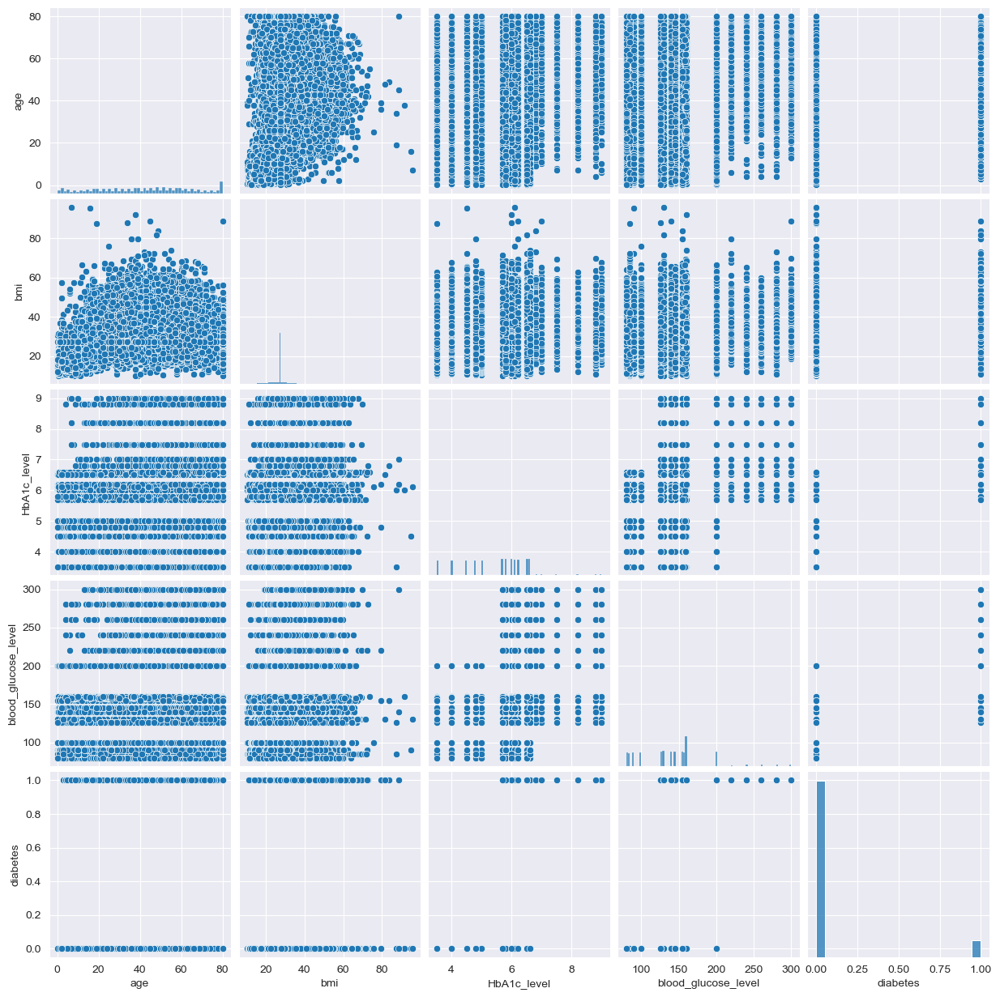

In [28]:
sns.pairplot(numeric)

In [35]:

# Create heatmap figure
fig = px.imshow(df.corr(), color_continuous_scale='PuBu')

# Update axis labels and title
fig.update_layout(
    xaxis_title='Features',
    yaxis_title='Features',
    title='Correlation Heatmap'
)

# Show the figure
fig.show()

### Feature engeneering

In [125]:
print(df.shape)
df.head()

(96128, 9)


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0


### Apply one hot encoder to age, bmi, HbA1c and blood glucose level

In [126]:

# Define the columns and their corresponding binning configurations
columns_to_binning = {
    'age': {'bins': [0, 18, 30, 50, float('inf')], 'labels': ['Child', 'Young Adult', 'Adult', 'Senior']},
    'HbA1c_level': {'bins': [0, 5.7, 6.4, float('inf')], 'labels': ['Normal', 'Pre-Diabetic', 'Diabetic']},
    'blood_glucose_level': {'bins': [0, 100, 125, float('inf')], 'labels': ['Normal', 'Pre-Diabetic', 'Diabetic']},
    'bmi': {'bins': [0, 18.5, 24.9, 29.9,34.9, float('inf')], 'labels': ['Underweight', 'Normal', 'Overweight', 'Obese','Extreme-obese']}
}
# Create a new DataFrame to store the results
df1 = df.copy()

# Apply binning to the specified columns and create dummies
for column, config in columns_to_binning.items():
    bin_labels = config['labels']
    bin_bins = config['bins']
    
    bin_groups = pd.cut(df[column], bins=bin_bins, labels=bin_labels, right=False)
    bin_dummies = pd.get_dummies(bin_groups, prefix=f'{column}')
    
    # Add the bin dummies to the original DataFrame
    df1 = pd.concat([df1, bin_dummies], axis=1)


In [127]:
df1

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes,age_Child,...,HbA1c_level_Pre-Diabetic,HbA1c_level_Diabetic,blood_glucose_level_Normal,blood_glucose_level_Pre-Diabetic,blood_glucose_level_Diabetic,bmi_Underweight,bmi_Normal,bmi_Overweight,bmi_Obese,bmi_Extreme-obese
0,Female,80.0,0,1,never,25.19,6.6,140,0,0,...,0,1,0,0,1,0,0,1,0,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0,0,...,0,1,1,0,0,0,0,1,0,0
2,Male,28.0,0,0,never,27.32,5.7,158,0,0,...,1,0,0,0,1,0,0,1,0,0
3,Female,36.0,0,0,current,23.45,5.0,155,0,0,...,0,0,0,0,1,0,1,0,0,0
4,Male,76.0,1,1,current,20.14,4.8,155,0,0,...,0,0,0,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,Female,36.0,0,0,No Info,24.60,4.8,145,0,0,...,0,0,0,0,1,0,1,0,0,0
99996,Female,2.0,0,0,No Info,17.37,6.5,100,0,1,...,0,1,0,1,0,1,0,0,0,0
99997,Male,66.0,0,0,former,27.83,5.7,155,0,0,...,1,0,0,0,1,0,0,1,0,0
99998,Female,24.0,0,0,never,35.42,4.0,100,0,0,...,0,0,0,1,0,0,0,0,0,1


In [128]:
df1.columns

Index(['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history',
       'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes', 'age_Child',
       'age_Young Adult', 'age_Adult', 'age_Senior', 'HbA1c_level_Normal',
       'HbA1c_level_Pre-Diabetic', 'HbA1c_level_Diabetic',
       'blood_glucose_level_Normal', 'blood_glucose_level_Pre-Diabetic',
       'blood_glucose_level_Diabetic', 'bmi_Underweight', 'bmi_Normal',
       'bmi_Overweight', 'bmi_Obese', 'bmi_Extreme-obese'],
      dtype='object')

### Apply get_dummies to "smoking_history" and 'gender' columns

In [129]:
df2=pd.get_dummies(df1)
df2

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes,age_Child,age_Young Adult,age_Adult,...,bmi_Obese,bmi_Extreme-obese,gender_Female,gender_Male,smoking_history_No Info,smoking_history_current,smoking_history_ever,smoking_history_former,smoking_history_never,smoking_history_not current
0,80.0,0,1,25.19,6.6,140,0,0,0,0,...,0,0,1,0,0,0,0,0,1,0
1,54.0,0,0,27.32,6.6,80,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0
2,28.0,0,0,27.32,5.7,158,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0
3,36.0,0,0,23.45,5.0,155,0,0,0,1,...,0,0,1,0,0,1,0,0,0,0
4,76.0,1,1,20.14,4.8,155,0,0,0,0,...,0,0,0,1,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,36.0,0,0,24.60,4.8,145,0,0,0,1,...,0,0,1,0,1,0,0,0,0,0
99996,2.0,0,0,17.37,6.5,100,0,1,0,0,...,0,0,1,0,1,0,0,0,0,0
99997,66.0,0,0,27.83,5.7,155,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
99998,24.0,0,0,35.42,4.0,100,0,0,1,0,...,0,1,1,0,0,0,0,0,1,0


In [130]:
df2.columns

Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'diabetes', 'age_Child', 'age_Young Adult',
       'age_Adult', 'age_Senior', 'HbA1c_level_Normal',
       'HbA1c_level_Pre-Diabetic', 'HbA1c_level_Diabetic',
       'blood_glucose_level_Normal', 'blood_glucose_level_Pre-Diabetic',
       'blood_glucose_level_Diabetic', 'bmi_Underweight', 'bmi_Normal',
       'bmi_Overweight', 'bmi_Obese', 'bmi_Extreme-obese', 'gender_Female',
       'gender_Male', 'smoking_history_No Info', 'smoking_history_current',
       'smoking_history_ever', 'smoking_history_former',
       'smoking_history_never', 'smoking_history_not current'],
      dtype='object')

### Intractions between:
1. blood glucose levels & HbA1c, 
2. Age&bmi 
3. bmi&hypertension
4. hypertension &heart_disease &age
Those parameters seems to have connection

In [168]:
df3=df2.copy()
df3['HbA1c_blood_gluc']=df2['HbA1c_level']*df2['blood_glucose_level']
df3['age_bmi']=df2['age']*df2['bmi']
df3['age-hypertension-heart_disease']=df2['age']*df2['hypertension']*df2['heart_disease']
df3['bmi-hypertension']=df2['bmi']*df2['hypertension']
df3

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes,age_Child,age_Young Adult,age_Adult,...,smoking_history_No Info,smoking_history_current,smoking_history_ever,smoking_history_former,smoking_history_never,smoking_history_not current,HbA1c_blood_gluc,age_bmi,age-hypertension-heart_disease,bmi-hypertension
0,80.0,0,1,25.19,6.6,140,0,0,0,0,...,0,0,0,0,1,0,924.0,2015.20,0.0,0.00
1,54.0,0,0,27.32,6.6,80,0,0,0,0,...,1,0,0,0,0,0,528.0,1475.28,0.0,0.00
2,28.0,0,0,27.32,5.7,158,0,0,1,0,...,0,0,0,0,1,0,900.6,764.96,0.0,0.00
3,36.0,0,0,23.45,5.0,155,0,0,0,1,...,0,1,0,0,0,0,775.0,844.20,0.0,0.00
4,76.0,1,1,20.14,4.8,155,0,0,0,0,...,0,1,0,0,0,0,744.0,1530.64,76.0,20.14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,36.0,0,0,24.60,4.8,145,0,0,0,1,...,1,0,0,0,0,0,696.0,885.60,0.0,0.00
99996,2.0,0,0,17.37,6.5,100,0,1,0,0,...,1,0,0,0,0,0,650.0,34.74,0.0,0.00
99997,66.0,0,0,27.83,5.7,155,0,0,0,0,...,0,0,0,1,0,0,883.5,1836.78,0.0,0.00
99998,24.0,0,0,35.42,4.0,100,0,0,1,0,...,0,0,0,0,1,0,400.0,850.08,0.0,0.00


In [169]:
df3.columns

Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'diabetes', 'age_Child', 'age_Young Adult',
       'age_Adult', 'age_Senior', 'HbA1c_level_Normal',
       'HbA1c_level_Pre-Diabetic', 'HbA1c_level_Diabetic',
       'blood_glucose_level_Normal', 'blood_glucose_level_Pre-Diabetic',
       'blood_glucose_level_Diabetic', 'bmi_Underweight', 'bmi_Normal',
       'bmi_Overweight', 'bmi_Obese', 'bmi_Extreme-obese', 'gender_Female',
       'gender_Male', 'smoking_history_No Info', 'smoking_history_current',
       'smoking_history_ever', 'smoking_history_former',
       'smoking_history_never', 'smoking_history_not current',
       'HbA1c_blood_gluc', 'age_bmi', 'age-hypertension-heart_disease',
       'bmi-hypertension'],
      dtype='object')

In [170]:
#rename columns
new_names={'HbA1c_Normal':'HbA1c_level_Normal','HbA1c_Pre-Diabetic':'HbA1c_level_Pre-Diabetic',\
           'HbA1c_Diabetic':'HbA1c_level_Diabetic','blood_glucose_Normal':'blood_glucose_level_Normal',\
           'blood_glucose_Pre-Diabetic':'blood_glucose_level_Pre-Diabetic',
           'blood_glucose_Diabetic':'blood_glucose_level_Diabetic','smoking_No Info':'smoking_history_No Info',\
           'smoking_current':'smoking_history_current','smoking_ever':'smoking_history_ever', \
           'smoking_former':'smoking_history_former','smoking_never':'smoking_history_never',\
           'smoking_not current':'smoking_history_not current' }
df3=df3.rename(columns=new_names)
df3

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes,age_Child,age_Young Adult,age_Adult,...,smoking_history_No Info,smoking_history_current,smoking_history_ever,smoking_history_former,smoking_history_never,smoking_history_not current,HbA1c_blood_gluc,age_bmi,age-hypertension-heart_disease,bmi-hypertension
0,80.0,0,1,25.19,6.6,140,0,0,0,0,...,0,0,0,0,1,0,924.0,2015.20,0.0,0.00
1,54.0,0,0,27.32,6.6,80,0,0,0,0,...,1,0,0,0,0,0,528.0,1475.28,0.0,0.00
2,28.0,0,0,27.32,5.7,158,0,0,1,0,...,0,0,0,0,1,0,900.6,764.96,0.0,0.00
3,36.0,0,0,23.45,5.0,155,0,0,0,1,...,0,1,0,0,0,0,775.0,844.20,0.0,0.00
4,76.0,1,1,20.14,4.8,155,0,0,0,0,...,0,1,0,0,0,0,744.0,1530.64,76.0,20.14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,36.0,0,0,24.60,4.8,145,0,0,0,1,...,1,0,0,0,0,0,696.0,885.60,0.0,0.00
99996,2.0,0,0,17.37,6.5,100,0,1,0,0,...,1,0,0,0,0,0,650.0,34.74,0.0,0.00
99997,66.0,0,0,27.83,5.7,155,0,0,0,0,...,0,0,0,1,0,0,883.5,1836.78,0.0,0.00
99998,24.0,0,0,35.42,4.0,100,0,0,1,0,...,0,0,0,0,1,0,400.0,850.08,0.0,0.00


In [171]:
df3=df3.drop(["age","bmi","HbA1c_level","blood_glucose_level"], axis=1)
df3

,hypertension,heart_disease,diabetes,age_Child,age_Young Adult,age_Adult,age_Senior,HbA1c_level_Normal,HbA1c_level_Pre-Diabetic,HbA1c_level_Diabetic,...,smoking_history_No Info,smoking_history_current,smoking_history_ever,smoking_history_former,smoking_history_never,smoking_history_not current,HbA1c_blood_gluc,age_bmi,age-hypertension-heart_disease,bmi-hypertension
0,0,1,0,0,0,0,1,0,0,1,...,0,0,0,0,1,0,924.0,2015.20,0.0,0.00
1,0,0,0,0,0,0,1,0,0,1,...,1,0,0,0,0,0,528.0,1475.28,0.0,0.00
2,0,0,0,0,1,0,0,0,1,0,...,0,0,0,0,1,0,900.6,764.96,0.0,0.00
3,0,0,0,0,0,1,0,1,0,0,...,0,1,0,0,0,0,775.0,844.20,0.0,0.00
4,1,1,0,0,0,0,1,1,0,0,...,0,1,0,0,0,0,744.0,1530.64,76.0,20.14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,0,0,0,0,0,1,0,1,0,0,...,1,0,0,0,0,0,696.0,885.60,0.0,0.00
99996,0,0,0,1,0,0,0,0,0,1,...,1,0,0,0,0,0,650.0,34.74,0.0,0.00
99997,0,0,0,0,0,0,1,0,1,0,...,0,0,0,1,0,0,883.5,1836.78,0.0,0.00
99998,0,0,0,0,1,0,0,1,0,0,...,0,0,0,0,1,0,400.0,850.08,0.0,0.00


In [172]:
#Breakpoint
diabetes_breakpoint = df3.copy()
diabetes_breakpoint.to_csv('diabetes_breakpoint.csv')


### Correlation matrix to the new df

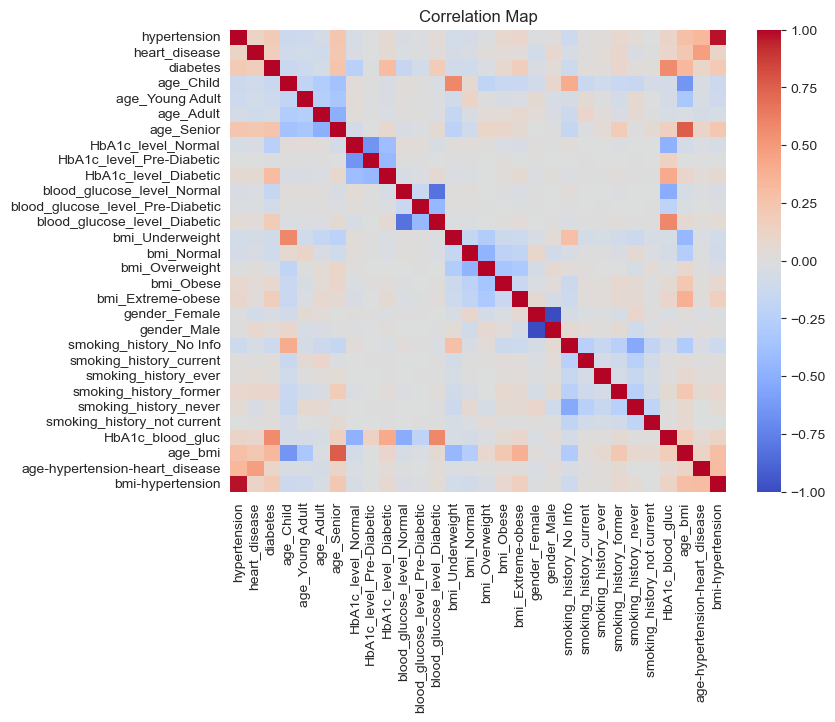

In [173]:


# Compute the correlation matrix
correlation_matrix = diabetes_breakpoint.corr()

# Create a correlation map using seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.title('Correlation Map')
plt.show()








Feature Scaling: If the numerical columns like 'age', 'bmi', 'HbA1c_level', and 'blood_glucose_level' have different scales, you can consider applying feature scaling techniques such as normalization (min-max scaling) or standardization (Z-score scaling) to bring them to a similar scale. This can help in improving the performance of certain machine learning algorithms.

One-Hot Encoding: If any of the categorical columns like 'gender' or 'hypertension' are not represented as numerical values, you can apply one-hot encoding to convert them into binary columns representing each category. This allows the machine learning algorithms to effectively work with categorical data.

Feature Crosses: You can create new features by combining two or more existing features. For example, you can create a feature by combining 'heart_disease' and 'hypertension' to represent the presence of both conditions.

Feature Aggregation: If you have additional data available, you can aggregate information at a higher level. For example, you can calculate the average 'blood_glucose_level' for each 'gender' category or calculate the maximum 'age' within each 'diabetes' group.

When dealing with imbalanced data, there are several steps you can take to test feature importance using a decision tree and address the class imbalance through under/over sampling. Here's a suggested sequence of steps:

Split the data: Split your dataset into training and testing sets. This ensures that you evaluate the model's performance on unseen data later.

Assess class imbalance: Examine the distribution of classes in your training data. Determine the extent of class imbalance, as this will guide your decision on which sampling techniques to use.

Build a baseline model: Train a decision tree classifier on the imbalanced training data without any sampling techniques. This will serve as your baseline model to compare with the models trained after sampling.

Evaluate feature importance: Use the trained decision tree model to assess the importance of features in predicting the target variable. Decision trees provide a built-in mechanism to measure feature importance based on criteria such as information gain or Gini impurity.

Apply under/over sampling: Depending on the severity of class imbalance, you can apply under-sampling (e.g., random undersampling, cluster-based undersampling) or over-sampling (e.g., random oversampling, SMOTE - Synthetic Minority Over-sampling Technique) techniques to address the imbalance. Under-sampling reduces the majority class instances, while over-sampling increases the minority class instances. Choose the appropriate technique based on the characteristics of your dataset.

Train models with sampled data: Train new decision tree models using the sampled training data obtained from the previous step. This helps to create a more balanced representation of the classes.

Evaluate model performance: Evaluate the performance of the decision tree models using the imbalanced test data. Compare the performance of the baseline model (trained without sampling) with the models trained using the sampled data. Metrics such as accuracy, precision, recall, F1-score, and area under the ROC curve (AUC-ROC) can be used to assess the model's performance.

### Test feature importance by Decision tree
### A base line model to to compare with the models trained after sampling.


In [174]:
#Spliting the data :  
X = diabetes_breakpoint.drop('diabetes', axis=1)
y = diabetes_breakpoint.diabetes

X_train, X_test, y_train, y_test = split(X, y, 
                                        train_size=0.75, 
                                        test_size=0.25,
                                        shuffle=True, 
                                        stratify=diabetes_breakpoint.diabetes)


In [175]:
#instanciation & fit
dt_model = DecisionTreeClassifier(min_samples_leaf=6).fit(X_train, y_train)

In [176]:
#Inspecting the model 
dt_model.classes_



array([0, 1], dtype=int64)

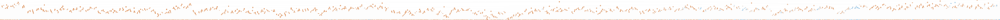

In [167]:
#Visualization: 

dot_data = StringIO()
class_names = list(map(str, dt_model.classes_))
export_graphviz(dt_model, out_file=dot_data, feature_names=X.columns.astype(str),
                leaves_parallel=True, filled=True, class_names=class_names)
graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]
Image(graph.create_png(), width=1000)

<AxesSubplot:title={'center':'Feature importances'}>

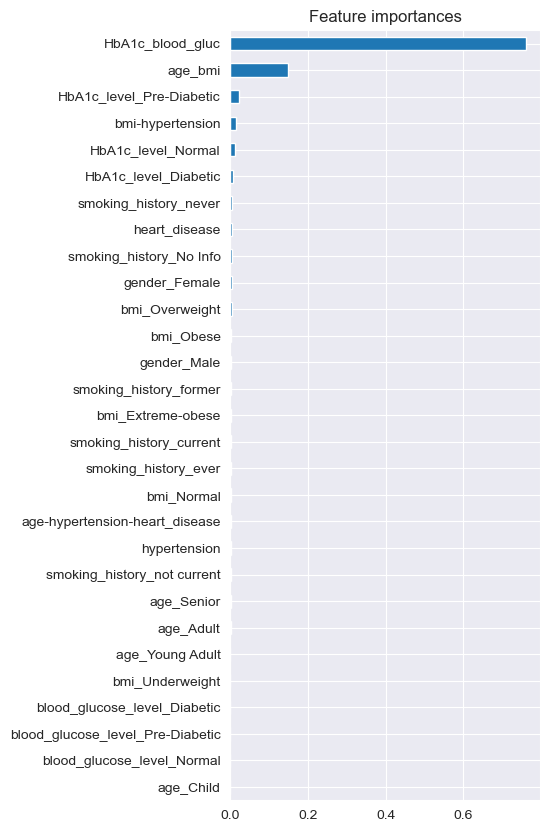

In [177]:
#Feature importance
pd.Series(dt_model.feature_importances_, index=X_train.columns).sort_values()\
    .plot.barh(figsize=(4, 10), rot=0, title='Feature importances')


In [178]:
#Feature importance
pd.Series(dt_model.feature_importances_, index=X_train.columns).sort_values()

age_Child                           0.000000
blood_glucose_level_Normal          0.000000
blood_glucose_level_Pre-Diabetic    0.000000
blood_glucose_level_Diabetic        0.000000
bmi_Underweight                     0.000041
age_Young Adult                     0.000044
age_Adult                           0.000391
age_Senior                          0.000455
smoking_history_not current         0.000596
hypertension                        0.000753
age-hypertension-heart_disease      0.000976
bmi_Normal                          0.001048
smoking_history_ever                0.001283
smoking_history_current             0.001594
bmi_Extreme-obese                   0.001678
smoking_history_former              0.001945
gender_Male                         0.002416
bmi_Obese                           0.002533
bmi_Overweight                      0.002728
gender_Female                       0.002992
smoking_history_No Info             0.003474
heart_disease                       0.004248
smoking_hi

In [179]:
#Assessing the model : First we apply the classification model to the (training) data.
diabetes_breakpoint['target_pred'] = dt_model.predict(X)
diabetes_breakpoint.head(6)


,hypertension,heart_disease,diabetes,age_Child,age_Young Adult,age_Adult,age_Senior,HbA1c_level_Normal,HbA1c_level_Pre-Diabetic,HbA1c_level_Diabetic,...,smoking_history_current,smoking_history_ever,smoking_history_former,smoking_history_never,smoking_history_not current,HbA1c_blood_gluc,age_bmi,age-hypertension-heart_disease,bmi-hypertension,target_pred
0,0,1,0,0,0,0,1,0,0,1,...,0,0,0,1,0,924.0,2015.20,0.0,0.00,0
1,0,0,0,0,0,0,1,0,0,1,...,0,0,0,0,0,528.0,1475.28,0.0,0.00,0
2,0,0,0,0,1,0,0,0,1,0,...,0,0,0,1,0,900.6,764.96,0.0,0.00,0
3,0,0,0,0,0,1,0,1,0,0,...,1,0,0,0,0,775.0,844.20,0.0,0.00,0
4,1,1,0,0,0,0,1,1,0,0,...,1,0,0,0,0,744.0,1530.64,76.0,20.14,0
5,0,0,0,0,1,0,0,0,0,1,...,0,0,0,1,0,561.0,546.40,0.0,0.00,0


In [180]:
#Validation
#confusion matrix
cm = confusion_matrix(y_true=y,
                      y_pred=diabetes_breakpoint.target_pred)
pd.DataFrame(cm,
             index=dt_model.classes_,
             columns=dt_model.classes_)
# We didn't treated the imbalanced data and we mistake a lot in the positive ( underrepresented target) - make sence


,0,1
0,87005,641
1,2233,6249


In [181]:
#classification report 
print(classification_report(y_true=y,
                            y_pred=diabetes_breakpoint.target_pred))


              precision    recall  f1-score   support

           0       0.97      0.99      0.98     87646
           1       0.91      0.74      0.81      8482

    accuracy                           0.97     96128
   macro avg       0.94      0.86      0.90     96128
weighted avg       0.97      0.97      0.97     96128



In [182]:
y_train_pred = pd.DataFrame(dt_model.predict_proba(X_train), 
                            columns=dt_model.classes_)
log_loss(y_train, y_train_pred)



0.053355576663546726

In [183]:
y_test_pred = pd.DataFrame(dt_model.predict_proba(X_test), 
                        columns=dt_model.classes_)
log_loss(y_test, y_test_pred)


0.6246750791155138

### imbalanced data

In [34]:
from collections import Counter
counter = Counter(y)
print(counter) 


# df['diabetes'].value_counts()
# # The data is imbalanced

Counter({'e': 2, 'd': 1, 'a': 1, 'i': 1, 'b': 1, 't': 1, 's': 1})


In [ ]:
# scatter plot of examples by class label
for label, _ in counter.items():
 row_ix = where(y == label)[0]
 pyplot.scatter(X[row_ix, 0], X[row_ix, 1], label=str(label))
pyplot.legend()
pyplot.show()



'LearnLearnLearn'